In [6]:
# Importing all the Required Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import datetime as dt
import warnings
plt.style.use('dark_background')
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns',None)
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

In [7]:
df=pd.read_csv('Life Expectancy Data.csv')
df.head()

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,83,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,86,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,89,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,93,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,97,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5


In [8]:
# Size of the data 
df.shape

(11750, 22)

In [9]:
# A Quick Information about the Data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11750 entries, 0 to 11749
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          11750 non-null  object 
 1   Year                             11750 non-null  int64  
 2   Status                           11750 non-null  object 
 3   Life expectancy                  11710 non-null  float64
 4   Adult Mortality                  11710 non-null  float64
 5   infant deaths                    11750 non-null  int64  
 6   Alcohol                          10974 non-null  float64
 7   percentage expenditure           11750 non-null  float64
 8   Hepatitis B                      9538 non-null   float64
 9   Measles                          11750 non-null  int64  
 10   BMI                             11614 non-null  float64
 11  under-five deaths                11750 non-null  int64  
 12  Polio             

In [10]:
# Checking for Null Values
df.isnull().sum()

Country                               0
Year                                  0
Status                                0
Life expectancy                      40
Adult Mortality                      40
infant deaths                         0
Alcohol                             776
percentage expenditure                0
Hepatitis B                        2212
Measles                               0
 BMI                                136
under-five deaths                     0
Polio                                76
Total expenditure                   904
Diphtheria                           76
 HIV/AIDS                             0
GDP                                1792
Population                         2608
thinness  1-19 years                136
thinness 5-9 years                  136
Income composition of resources     668
Schooling                           652
dtype: int64

In [11]:
# Replacing the Null Values with mean values of the data
from sklearn.impute import SimpleImputer
imputer=SimpleImputer(missing_values=np.nan,strategy='mean',fill_value=None)
df['Life expectancy ']=imputer.fit_transform(df[['Life expectancy ']])
df['Adult Mortality']=imputer.fit_transform(df[['Adult Mortality']])
df['Alcohol']=imputer.fit_transform(df[['Alcohol']])
df['Hepatitis B']=imputer.fit_transform(df[['Hepatitis B']])
df[' BMI ']=imputer.fit_transform(df[[' BMI ']])
df['Polio']=imputer.fit_transform(df[['Polio']])
df['Total expenditure']=imputer.fit_transform(df[['Total expenditure']])
df['Diphtheria ']=imputer.fit_transform(df[['Diphtheria ']])
df['GDP']=imputer.fit_transform(df[['GDP']])
df['Population']=imputer.fit_transform(df[['Population']])
df['thinness  1-19 years']=imputer.fit_transform(df[['thinness  1-19 years']])
df['thinness 5-9 years']=imputer.fit_transform(df[['thinness 5-9 years']])
df['Income composition of resources']=imputer.fit_transform(df[['Income composition of resources']])
df['Schooling']=imputer.fit_transform(df[['Schooling']])

In [12]:
df.isnull().sum()

Country                            0
Year                               0
Status                             0
Life expectancy                    0
Adult Mortality                    0
infant deaths                      0
Alcohol                            0
percentage expenditure             0
Hepatitis B                        0
Measles                            0
 BMI                               0
under-five deaths                  0
Polio                              0
Total expenditure                  0
Diphtheria                         0
 HIV/AIDS                          0
GDP                                0
Population                         0
thinness  1-19 years               0
thinness 5-9 years                 0
Income composition of resources    0
Schooling                          0
dtype: int64

In [13]:
df.describe()

,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
count,11750.000000,11750.000000,11750.000000,11750.000000,11750.000000,11750.000000,11750.000000,11750.000000,11750.000000,11750.000000,11750.000000,11750.000000,11750.000000,11750.000000,11750.000000,1.175000e+04,11750.000000,11750.000000,11750.000000,11750.000000
mean,2007.520000,69.228898,164.711016,30.305021,4.603393,738.376955,80.940868,2419.751660,38.323454,42.036255,82.550968,5.937975,82.324824,1.734996,7484.551480,1.275349e+07,4.838643,4.869227,0.627586,11.993188
std,4.612601,9.502404,123.903237,117.921454,3.915935,1987.806917,22.585879,11466.777956,19.926126,160.438715,23.351074,2.400124,23.639000,5.048249,13135.929590,5.381317e+07,4.393613,4.481756,0.204795,3.264117
min,2000.000000,36.300000,1.000000,0.000000,0.010000,0.000000,1.000000,0.000000,1.000000,0.000000,3.000000,0.370000,2.000000,0.100000,1.681350,3.400000e+01,0.100000,0.100000,0.000000,0.000000
25%,2004.000000,63.200000,74.000000,0.000000,1.090000,4.685343,80.940868,0.000000,19.400000,0.000000,78.000000,4.370000,78.000000,0.100000,580.486996,4.187380e+05,1.600000,1.600000,0.504250,10.300000
50%,2008.000000,72.000000,144.000000,3.000000,4.160000,64.969645,87.000000,17.000000,43.000000,4.000000,93.000000,5.937975,93.000000,0.100000,3119.637160,3.662993e+06,3.400000,3.400000,0.662000,12.100000
75%,2012.000000,75.600000,227.000000,22.000000,7.390000,441.844624,96.000000,360.250000,56.100000,28.000000,97.000000,7.330000,97.000000,0.800000,7484.551480,1.275349e+07,7.100000,7.200000,0.772000,14.100000
max,2015.000000,89.000000,723.000000,1800.000000,17.870000,19479.911610,99.000000,212183.000000,87.300000,2500.000000,99.000000,17.600000,99.000000,50.600000,119172.741800,1.293859e+09,27.700000,28.600000,0.948000,20.700000


In [14]:
df.head()

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,83,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,86,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,89,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,93,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,97,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5


In [15]:
df.corr().head()

,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
Year,1.000000,0.169071,-0.077870,-0.037438,-0.048375,0.031304,0.089392,-0.082534,0.108177,-0.042952,0.093787,0.082006,0.133833,-0.138289,0.093228,0.014951,-0.047222,-0.050255,0.236143,0.203339
Life expectancy,0.169071,1.000000,-0.695999,-0.196658,0.391505,0.381835,0.203838,-0.157688,0.559292,-0.222624,0.461729,0.208293,0.475585,-0.556532,0.430501,-0.019652,-0.471895,-0.466356,0.692492,0.715175
Adult Mortality,-0.077870,-0.695999,1.000000,0.078894,-0.190165,-0.242897,-0.138723,0.031274,-0.381551,0.094279,-0.272938,-0.111366,-0.273267,0.521814,-0.277078,-0.012512,0.299364,0.304870,-0.440054,-0.435264
infant deaths,-0.037438,-0.196658,0.078894,1.000000,-0.113825,-0.085617,-0.178784,0.501128,-0.227234,0.996629,-0.170676,-0.126562,-0.175159,0.025453,-0.107117,0.548522,0.465681,0.471321,-0.143681,-0.191770
Alcohol,-0.048375,0.391505,-0.190165,-0.113825,1.000000,0.339604,0.075441,-0.051069,0.318016,-0.110785,0.213730,0.294980,0.215230,-0.047885,0.318547,-0.030768,-0.416856,-0.405789,0.416034,0.497506


# Correlation Calculated Using:  (cov(X,Y)= ∑Ni=1(Xi−¯X)(Yi−¯Y)N ∑ i = 1 N ( X i − X ¯ ) ( Y i − Y ¯ ) N 

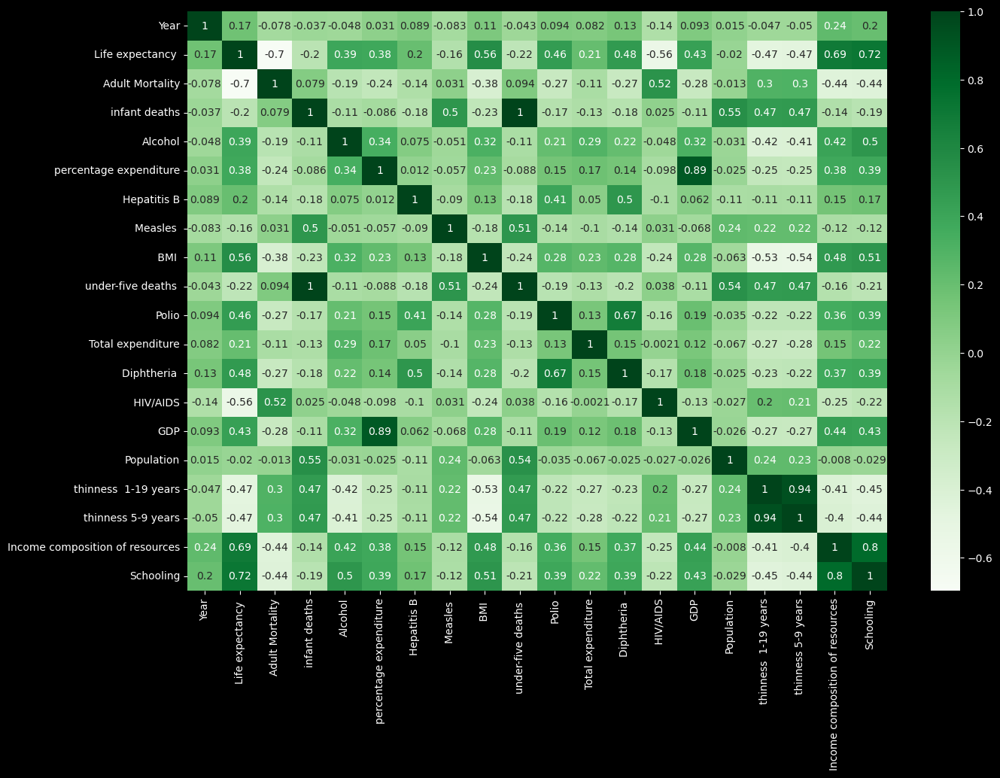

In [16]:
plt.figure(figsize=(15,10))
sns.heatmap(df.corr(),annot=True,cmap='Greens')
plt.show()

In [17]:
fig=px.histogram(df,x='Life expectancy ',template='plotly_dark')
fig.show()

<b> DEVELOPED COUNTRIES HAS MAXIMUM LIFE EXPENTANCY

In [18]:
fig=px.violin(df,x='Status',y='Life expectancy ',color='Status',template='plotly_dark',box=True,title='Life expectancy Based on Countries status')
fig.show()

In [19]:
fig=px.line(df.sort_values(by='Year'),x='Year',y='Life expectancy ',animation_frame='Country',animation_group='Year',color='Country',markers=True,template='plotly_dark',title='<b> Country wise Life Expectancy over Years')
fig.show()

In [38]:
px.scatter(df,y='Adult Mortality',x='Life expectancy ',color='Country',size='Life expectancy ',template='plotly_dark',opacity=0.6,title='<b> Life Expectancy Versus Adult Mortality')

In [20]:
px.scatter(df,x='Life expectancy ',y='percentage expenditure',color='Country',size='Year',template='plotly_dark',title='<b> Life Expectancy Versus Percentage expenditure')

#### DECREASE IN INFANT DEATHS INCREASES LIFE EXPECTANCY

In [21]:
px.scatter(df.sort_values(by='Year'),y='infant deaths',x='Life expectancy ',template='plotly_dark',size='Year',color='Country',opacity=0.6,title='<b>Life Expectancy Versus Infant Deaths of Countries in every Year')

In [22]:
px.scatter_3d(df.sort_values(by='Year'),y='Schooling',x='Life expectancy ',z='Total expenditure',template='plotly_dark',color='Country',size='Total expenditure')

In [23]:
px.scatter_3d(df.sort_values(by='Year'),y='Adult Mortality',x='Life expectancy ',z='infant deaths',size='Life expectancy ',template='plotly_dark',color='Country')

In [24]:
px.scatter(df.sort_values(by='Year'),y='Schooling',x='Life expectancy ',animation_frame='Year',animation_group='Country',template='plotly_dark',color='Country',size='Life expectancy ',title='<b> Life expectancy versus Schooling of countries in every year')

In [25]:
px.scatter(df.sort_values(by='Year'),y='Adult Mortality',x='Life expectancy ',animation_frame='Year',animation_group='Country',color='Country',size='Life expectancy ',opacity=0.6,template='plotly_dark',title='<b> Life Expectancy Versus Adult Mortality in every year')

In [26]:
px.scatter(df.sort_values(by='Year'),y=' BMI ',x='Life expectancy ',animation_frame='Year',animation_group='Country',template='plotly_dark',color='Country',size='Life expectancy ',opacity=0.6,title='<b> Life expectancy versus BMI of Countries in every Year')

In [27]:
px.scatter(df.sort_values(by='Year'),y='GDP',x='Life expectancy ',animation_frame='Year',animation_group='Country',template='plotly_dark',color='Country',size='Life expectancy ',title='<b>Life Expectancy Versus GDP of Countries in every Year')